 Cultural Remix
======
### Amar Shah and Sonia Nigam
#### EECS352


In [1]:
# This line is a convenience to import most packages you'll need. You may need to import others (eg random and cmath)
import IPython, numpy as np, scipy as sp, matplotlib.pyplot as plt, matplotlib, sklearn, librosa, cmath,math
from IPython.display import Audio
import librosa
import pickle
import os
from os import listdir
import msaf
from scipy.spatial.distance import euclidean
from fastdtw import fastdtw
import notebook

# This line makes sure your plots happen IN the webpage you're building, instead of in separate windows.
%matplotlib inline

/Users/amarshah/miniconda2/envs/eecs352/lib/python2.7/site-packages/matplotlib/font_manager.py:273: UserWarning: Matplotlib is building the font cache using fc-list. This may take a moment.
  warnings.warn('Matplotlib is building the font cache using fc-list. This may take a moment.')
/Users/amarshah/miniconda2/envs/eecs352/lib/python2.7/site-packages/IPython/html.py:14: ShimWarning: The `IPython.html` package has been deprecated. You should import from `notebook` instead. `IPython.html.widgets` has moved to `ipywidgets`.
  "`IPython.html.widgets` has moved to `ipywidgets`.", ShimWarning)


In [2]:
#taken from HW0
def wavwrite(filepath, data, sr, norm=True, dtype='int16',):
    '''
    Write wave file using scipy.io.wavefile.write, converting from a float (-1.0 : 1.0) numpy array to an integer array
    Parameters
    ----------
    filepath : str
        The path of the output .wav file
    data : np.array
        The float-type audio array
    sr : int
        The sampling rate
    norm : bool
        If True, normalize the audio to -1.0 to 1.0 before converting integer
    dtype : str
        The output type. Typically leave this at the default of 'int16'.
    '''
    if norm:
        data /= np.max(np.abs(data))
    data = data * np.iinfo(dtype).max
    data = data.astype(dtype)
    sp.io.wavfile.write(filepath, sr, data)

In [3]:
signal, sr = librosa.load('HipHop/Loyal.mp3', sr=44100)
D = librosa.stft(signal)

#split into two parts: percussive and harmonic
D_harmonic, D_percussive = librosa.decompose.hpss(D)

D_harmonic_audio = librosa.istft(D_harmonic)
D_percussive_audio = librosa.istft(D_percussive)

tune = np.concatenate((signal, D_harmonic_audio,D_percussive_audio))
tune2 = np.concatenate((D_harmonic_audio,D_percussive_audio ))
#saves percussive component
wavwrite('new.mp3', D_percussive_audio, sr)
#Audio(D_percussive_audio, rate=sr)

/Users/amarshah/miniconda2/envs/eecs352/lib/python2.7/site-packages/librosa/util/utils.py:1478: RuntimeWarning: invalid value encountered in divide
  mask /= mask + (X_ref / Z)**power


In [4]:
def get_music_samples(music, start_frame, end_frame, hop_length):
    """
        input:
            music - vector of samples for the musical signal - output by librosa.
            hop_length - hop_length for the feature vector computation
            start_frame - frame index to start at
            end_frame - frame index to end at
        output:
            chunk - samples corresponding to between and including the start and end frame
    """
    chunk = music[start_frame * hop_length: end_frame * hop_length]
    return chunk

In [5]:
hop_length = 512

#gets hip hop audio beats
tempo, beats = librosa.beat.beat_track(D_percussive_audio, sr=sr, hop_length=hop_length)

#get segment boundaries based on percussive background
boundaries, labels = msaf.process("new.mp3", boundaries_id="foote")
boundaries_final = [boundaries[0]]
#check to see if any samples are too close together, delete if so
for i in xrange(1,len(boundaries)-1):
    if boundaries[i] - boundaries[i-1] < 1.75:
        pass
    else:
        boundaries_final.append(boundaries[i])
    
#convert time indicies into frame indices
boundaries_frames = librosa.core.time_to_frames(boundaries_final, sr=sr)

/Users/amarshah/miniconda2/envs/eecs352/lib/python2.7/site-packages/numpy/core/numeric.py:482: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  return array(a, dtype, copy=False, order=order)


In [6]:
segments = []
print boundaries_frames
#grab music chunks corresponding to beat segments
for j in xrange(len(boundaries_frames)-1):
    segment = get_music_samples(D_percussive_audio, boundaries_frames[j], boundaries_frames[j+1], hop_length)
    segments.append(segment)

segments = np.array(segments)
tune = np.array([])

#testing --> tune should be entire percussive component of song
# print len(segments)
# for segment in segments:
#     plt.figure()
#     plt.plot(segment)
#     tune = np.concatenate((tune,segment))
# Audio(tune, rate=sr)

[    0   216  2256  3504  4916  7524 11075 12800 14316 16244 17132 19636
 22612]


In [7]:
indian_segments = []
counter = 0
#if indian segments exist, load, else populate the variable locally
try:
    indian_segments = pickle.load(open("indianSegments.pickle", "rb"))
except (OSError, IOError) as e:
    hop_length = 512
    for f in listdir('BeatsDatabase'):
        print counter
        if f == '.DS_Store':
            continue
        path = 'BeatsDatabase/' + f
    
        indian_song, sr = librosa.load(path, sr=44100) 
        #gets indian audio beats
        tempo, beats = librosa.beat.beat_track(indian_song, sr=sr, hop_length=hop_length)
        #get segment boundaries 
        boundaries, labels = msaf.process(path, boundaries_id="foote")

        boundaries_final = [boundaries[0]]
        #check to see if any samples are too close together, delete if so
        for i in xrange(1,len(boundaries)-1):
            if boundaries[i] - boundaries[i-1] < 1.75:
                pass
            else:
                boundaries_final.append(boundaries[i])
        #converts to frames
        boundaries_frames = librosa.core.time_to_frames(boundaries_final, sr=sr)

        #grab music chunks corresponding to beat segments
        for j in xrange(len(boundaries_frames)-1):
            segment = get_music_samples(indian_song, boundaries_frames[j], boundaries_frames[j+1], hop_length)
            indian_segments.append(segment)
        print len(indian_segments)
        counter += 1
    #convert to np array
    indian_segments = np.array(indian_segments)
    pickle.dump( indian_segments, open( "indianSegments.pickle", "wb" ) )


In [8]:
#make spectrogram of inputted music segment
def makeSpectrogram(music):
    hop_length = 1024
    n_fft = 2048
    stft = librosa.stft(music, hop_length = hop_length, n_fft = n_fft)
    log_spectrogram = librosa.logamplitude(np.abs(stft**2), ref_power=np.max)
    return log_spectrogram


In [9]:
Audio(indian_segments[51], rate = sr)

In [10]:
indian_segments = np.delete(indian_segments, [0,46,51], axis = 0)
Audio(indian_segments[0], rate = sr)

In [11]:
indian_spectrograms = []
counter = 0

#check if pickled indian spectrograms exist, if not populate with spectrograms of indian_segments
try:
    indian_spectrograms = pickle.load(open("indianSpectrograms.pickle", "rb"))
except (OSError, IOError) as e:
    for song in indian_segments:
        print counter
        print np.shape(song)
        spect = makeSpectrogram(song)
        indian_spectrograms.append(spect)
        counter += 1
    pickle.dump( indian_spectrograms, open( "indianSpectrograms.pickle", "wb" ) )


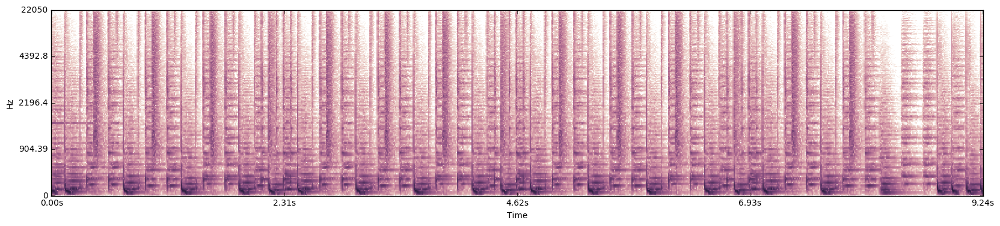

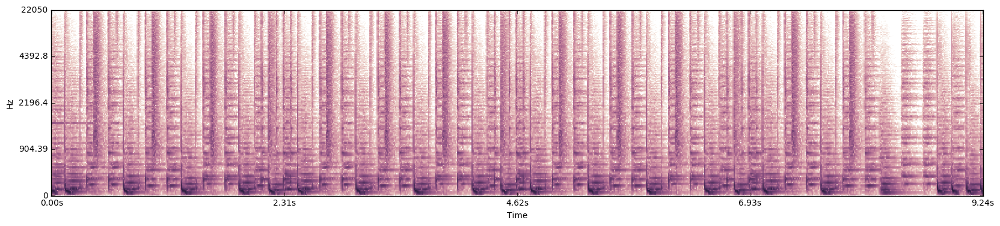

In [12]:
####TESTING TO MAKE SURE ORDER IS MAINTAINED IN PICKLING
from librosa import display

plt.figure(figsize=(20, 4))
librosa.display.specshow(np.array(indian_spectrograms[10]), sr = sr, hop_length = hop_length, y_axis = 'log', x_axis = 'time')
plt.show()
plt.figure()
plt.figure(figsize=(20, 4))

test = makeSpectrogram(indian_segments[10])
librosa.display.specshow(test, sr = sr, hop_length = hop_length, y_axis = 'log', x_axis = 'time')
plt.show()


In [13]:
## YOUR ANSWER GOES HERE

def cross_sim_matrix(segment1, segment2, sample_rate, hop_length, display = True):
    """
        Input:
            feature_vectors - a numpy ndarray MxN, where M is the number of features in each vector and 
            N is the length of the sequence.
            sample_rate - sample rate of the original audio
            hop_length - the length of the hop used in the representation
            distance_metric - which distance metric to use to compute similarity. Defaults to cosine.
            display - whether or not to display the similarity matrix after computing it. Defaults to True.
        Output:
            if display is True, plot the similarity matrix. Along the x and y axis of the similarity matrix, 
            the ticks should be in seconds not in samples. 
            returns sim_matrix - an NxN matrix with the pairwise distance between every feature vector.
    """
        
    D = sp.spatial.distance.cdist(segment1.T, segment2.T, metric='euclidean')

    #square up flattened array
    #D = sp.spatial.distance.squareform(D)
    #divide each element by max and then subtract from 1
    D_max = np.amax(D)  + .00000000001
    D = D / D_max
    S = 1 - D
    
    #plot figure
    if display == True:
        fig = plt.figure()
        plt.imshow(S, interpolation='nearest')
        skip_a = segment1.shape[-1] / 10
        skip_b = segment2.shape[-1] / 10
        plt.xticks(np.arange(0, segment1.shape[-1], skip_a), ['%.2f' % (i * hop_length / float(sample_rate)) for i in range(segment1.shape[-1])][::skip_a],rotation='vertical')
        plt.yticks(np .arange(0, segment2.shape[-1], skip_b), ['%.2f' % (i * hop_length / float(sample_rate)) for i in range(segment2.shape[-1])][::skip_b])
        plt.xlabel('Song Time (s)')
        plt.ylabel('Cover Time (s)')
        plt.title('Cross Similarity Matrix')
        plt.colorbar()
        plt.show()
    return S

# segment1 =  makeSpectrogram(segments[1])
# segment2 = makeSpectrogram(indian_segments[1])
# S = cross_sim_matrix(segment1, segment2, sr, hop_length, display = True)


In [14]:
compatible_indian_beats = []
counter = 0
print len(segments)
print len(indian_spectrograms)

for hiphop_beat in segments:
    hiphop_spect =  makeSpectrogram(hiphop_beat)
    #max_trace = float("-inf")
    min_dist = float("inf")
    similar_beat = 0
    for i in xrange(len(indian_spectrograms)):
        print counter
        #csm = cross_sim_matrix(hiphop_spect, indian_spectrograms[i], sr, hop_length, display = False)
        #current_trace = np.trace(csm)
        #print np.shape(hiphop_spect)
        #print np.shape(indian_spectrograms[i])
        current_dist, path = fastdtw(hiphop_spect.T, indian_spectrograms[i].T, dist=euclidean)
        if current_dist < min_dist:
            min_dist = current_dist
            similar_beat = i
#         if current_trace > max_trace:
#             max_trace = current_trace
#             similar_beat = i
        counter += 1
        
    compatible_indian_beats.append(similar_beat)
    print len(compatible_indian_beats)


12
104
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
1
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
2
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274

In [15]:
import sys
def fitSegments(hiphop_segments, indian_segments):
    length = len([num for sub in hiphop_segments for num in sub])
    final_tune = np.zeros(length)
    
    start = 0
    for i in xrange(len(hiphop_segments)):
        hiphop = np.array(hiphop_segments[i])
        indian = np.array(indian_segments[i])
        new_segment = np.zeros(len(hiphop))
        
        if len(hiphop) < len(indian):
            new_segment[:] = indian[:len(hiphop)]

        elif len(hiphop) > len(indian):
            current = []
            while len(current) < len(hiphop):
                current = np.concatenate((current,indian))
            new_segment[:] = current[:len(hiphop)]
        else:
            new_segment[:] = indian
            
        end = start + len(new_segment)
        final_tune[start:end] = new_segment
        start = end
    return final_tune

In [16]:
compatible_segments = []
for j in compatible_indian_beats:
    compatible_segments.append(indian_segments[j])

test = np.zeros(len([num for sub in compatible_segments for num in sub]))
test[:] = [num for sub in compatible_segments for num in sub]
#Audio(test , rate=sr)

indian_tune = fitSegments(segments, compatible_segments)

final_segs = [item for sublist in segments for item in sublist]
hiphop_tune = np.zeros(len(indian_tune))
hiphop_tune[:] = final_segs

# #print len(D_harmonic_audio)


In [17]:
import random 
indian_tune = indian_tune

intro_0 = indian_segments[45][0:300000]
intro_1 = indian_segments[38][55000:330000]

choice = random.randint(0,1)

if choice:
    indian_tune[0:len(intro_0)] = indian_tune[0:len(intro_0)] *.2
    indian_tune[0:len(intro_0)] += intro_0
else:
    indian_tune[0:len(intro_1)] = indian_tune[0:len(intro_1)] *.2
    indian_tune[0:len(intro_1)] += intro_1

final_song = indian_tune*.6 + D_harmonic_audio[:len(indian_tune)]
librosa.output.write_wav('loyalindian.mp3', final_song, sr)
Audio(final_song, rate=sr)

